In [140]:
from numba.core.extending import get_cython_function_address
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import glob
import datetime
import pytz
import pvlib

In [30]:
main_path = "/Users/nataly/opt/AnacondaProjects/SAPIENS/INVERTER/"

pathCDT = "/Users/nataly/opt/AnacondaProjects/SAPIENS/original/GERACAO/CR1000-Sapiens_HT_SP1_INV_CDT.csv"
pathPSI = "/Users/nataly/opt/AnacondaProjects/SAPIENS/original/GERACAO/CR1000-Sapiens_HT_SP1_INV_PSI.csv"


varCDT =['TIMESTAMP',
         'INV_CDTE_231',
         'INV_CDTE_236',
         'INV_CDTE_237',
         'INV_CDTE_238',
         'INV_CDTE_239',
         'INV_CDTE_240',
         'INV_CDTE_241',
         'INV_CDTE_242',
         'INV_CDTE_243',
         'INV_CDTE_244',
         'INV_CDTE_245',
         'INV_CDTE_246',
         'INV_CDTE_247',
         'INV_CDTE_248']


varCDTA = ['TIMESTAMP',
           'INV_CDTE_331',
           'INV_CDTE_336',
           'INV_CDTE_337',
           'INV_CDTE_338',
           'INV_CDTE_339',
           'INV_CDTE_340',
           'INV_CDTE_341',
           'INV_CDTE_342',
           'INV_CDTE_343',
           'INV_CDTE_344',
           'INV_CDTE_345',
           'INV_CDTE_346',
           'INV_CDTE_347',
           'INV_CDTE_348']

varPSI = ['TIMESTAMP',
          'INV_CDTE_431',
          'INV_CDTE_436',
          'INV_CDTE_437',
          'INV_CDTE_438',
          'INV_CDTE_439',
          'INV_CDTE_440',
          'INV_CDTE_441',
          'INV_CDTE_442',
          'INV_CDTE_443',
          'INV_CDTE_444',
          'INV_CDTE_445',
          'INV_CDTE_446',
          'INV_CDTE_447',
          'INV_CDTE_448']


column_names = ['TIMESTAMP',
                   'Etot',
                   'Vgrid',
                   'Igrid',
                   'Pgrid',
                   'Fgrid',
                   'Pin1',
                   'Vin1',
                   'Iin1',
                   'Pin2',
                   'Vin2',
                   'Iin2',
                   'Tinverter',
                   'Tbooster',
                   'Riso']
                   


In [31]:
dfCDT  = pd.read_csv(pathCDT, usecols=varCDT)



In [34]:
dfCDT.columns

Index(['TIMESTAMP', 'INV_CDTE_231', 'INV_CDTE_236', 'INV_CDTE_237',
       'INV_CDTE_238', 'INV_CDTE_239', 'INV_CDTE_240', 'INV_CDTE_241',
       'INV_CDTE_242', 'INV_CDTE_243', 'INV_CDTE_244', 'INV_CDTE_245',
       'INV_CDTE_246', 'INV_CDTE_247', 'INV_CDTE_248'],
      dtype='object')

In [32]:
dfCDT

,TIMESTAMP,INV_CDTE_231,INV_CDTE_236,INV_CDTE_237,INV_CDTE_238,INV_CDTE_239,INV_CDTE_240,INV_CDTE_241,INV_CDTE_242,INV_CDTE_243,INV_CDTE_244,INV_CDTE_245,INV_CDTE_246,INV_CDTE_247,INV_CDTE_248
0,2017-07-04 10:45:00,2193.921,234.6536,6.196396,1434.9640,59.98176,1479.3440,319.4513,4.700523,0.0,0,0,39.08350,33.51683,5.0
1,2017-07-04 10:46:00,2193.947,234.8455,6.196651,1439.2920,59.99952,1484.0010,319.8006,4.718031,0.0,0,0,39.08350,33.30969,5.0
2,2017-07-04 10:47:00,2193.972,234.7815,6.211050,1441.4260,60.00360,1486.0060,319.7704,4.747102,0.0,0,0,39.21859,33.41356,5.0
3,2017-07-04 10:48:00,2193.993,234.6642,6.275977,1450.1460,60.00192,1495.5130,320.0895,4.776174,0.0,0,0,39.24561,33.30969,5.0
4,2017-07-04 10:49:00,2194.021,234.4241,6.284834,1456.0430,59.98608,1501.0760,320.4254,4.810109,0.0,0,0,39.24561,33.15329,5.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1833799,2021-02-11 15:09:00,13115.830,215.2951,2.661140,552.9396,59.97337,570.0408,311.8500,1.941638,0.0,0,0,44.47314,38.33249,5.0
1833800,2021-02-11 15:10:00,13115.840,215.6855,2.843410,590.6448,60.01645,608.0389,312.9937,2.030582,0.0,0,0,44.47314,38.43271,5.0
1833801,2021-02-11 15:11:00,13115.840,215.6725,2.846778,598.1732,60.00326,615.9943,313.4791,2.041984,0.0,0,0,44.40621,38.42018,5.0
1833802,2021-02-11 15:12:00,13115.860,215.6638,2.798108,597.4203,59.97649,615.8973,313.7646,2.058465,0.0,0,0,44.31250,38.33249,5.0


In [35]:
dfCDT.columns = column_names

In [36]:
dfCDT.columns

Index(['TIMESTAMP', 'Etot', 'Vgrid', 'Igrid', 'Pgrid', 'Fgrid', 'Pin1', 'Vin1',
       'Iin1', 'Pin2', 'Vin2', 'Iin2', 'Tinverter', 'Tbooster', 'Riso'],
      dtype='object')

In [37]:
dfCDT

,TIMESTAMP,Etot,Vgrid,Igrid,Pgrid,Fgrid,Pin1,Vin1,Iin1,Pin2,Vin2,Iin2,Tinverter,Tbooster,Riso
0,2017-07-04 10:45:00,2193.921,234.6536,6.196396,1434.9640,59.98176,1479.3440,319.4513,4.700523,0.0,0,0,39.08350,33.51683,5.0
1,2017-07-04 10:46:00,2193.947,234.8455,6.196651,1439.2920,59.99952,1484.0010,319.8006,4.718031,0.0,0,0,39.08350,33.30969,5.0
2,2017-07-04 10:47:00,2193.972,234.7815,6.211050,1441.4260,60.00360,1486.0060,319.7704,4.747102,0.0,0,0,39.21859,33.41356,5.0
3,2017-07-04 10:48:00,2193.993,234.6642,6.275977,1450.1460,60.00192,1495.5130,320.0895,4.776174,0.0,0,0,39.24561,33.30969,5.0
4,2017-07-04 10:49:00,2194.021,234.4241,6.284834,1456.0430,59.98608,1501.0760,320.4254,4.810109,0.0,0,0,39.24561,33.15329,5.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1833799,2021-02-11 15:09:00,13115.830,215.2951,2.661140,552.9396,59.97337,570.0408,311.8500,1.941638,0.0,0,0,44.47314,38.33249,5.0
1833800,2021-02-11 15:10:00,13115.840,215.6855,2.843410,590.6448,60.01645,608.0389,312.9937,2.030582,0.0,0,0,44.47314,38.43271,5.0
1833801,2021-02-11 15:11:00,13115.840,215.6725,2.846778,598.1732,60.00326,615.9943,313.4791,2.041984,0.0,0,0,44.40621,38.42018,5.0
1833802,2021-02-11 15:12:00,13115.860,215.6638,2.798108,597.4203,59.97649,615.8973,313.7646,2.058465,0.0,0,0,44.31250,38.33249,5.0


In [39]:
dfCDTA = pd.read_csv(pathCDT, usecols=varCDTA)



In [40]:


dfCDTA.columns = column_names


In [43]:
dfPSI  = pd.read_csv(pathPSI, usecols=varPSI)



In [42]:
varPSI = ['TIMESTAMP',
          'INV_PSI_431',
          'INV_PSI_436',
          'INV_PSI_437',
          'INV_PSI_438',
          'INV_PSI_439',
          'INV_PSI_440',
          'INV_PSI_441',
          'INV_PSI_442',
          'INV_PSI_443',
          'INV_PSI_444',
          'INV_PSI_445',
          'INV_PSI_446',
          'INV_PSI_447',
          'INV_PSI_448']

In [44]:
dfPSI.columns = column_names


In [45]:
dfPSI.dtypes

TIMESTAMP     object
Etot         float64
Vgrid        float64
Igrid        float64
Pgrid        float64
Fgrid        float64
Pin1         float64
Vin1         float64
Iin1         float64
Pin2           int64
Vin2           int64
Iin2           int64
Tinverter    float64
Tbooster     float64
Riso         float64
dtype: object

In [46]:
print(dfCDT.shape)
dfCDT['TIMESTAMP'] = dfCDT['TIMESTAMP'].astype(np.datetime64)
dfCDT = dfCDT.fillna(-9999)
dfCDT = dfCDT.sort_values(by=['TIMESTAMP'])
dfCDT= dfCDT.drop_duplicates()
print(dfCDT.shape)

(1833804, 15)
(1828690, 15)


In [47]:
dfCDT

,TIMESTAMP,Etot,Vgrid,Igrid,Pgrid,Fgrid,Pin1,Vin1,Iin1,Pin2,Vin2,Iin2,Tinverter,Tbooster,Riso
0,2017-07-04 10:45:00,2193.921,234.6536,6.196396,1434.9640,59.98176,1479.3440,319.4513,4.700523,0.0,0,0,39.08350,33.51683,5.0
1,2017-07-04 10:46:00,2193.947,234.8455,6.196651,1439.2920,59.99952,1484.0010,319.8006,4.718031,0.0,0,0,39.08350,33.30969,5.0
2,2017-07-04 10:47:00,2193.972,234.7815,6.211050,1441.4260,60.00360,1486.0060,319.7704,4.747102,0.0,0,0,39.21859,33.41356,5.0
3,2017-07-04 10:48:00,2193.993,234.6642,6.275977,1450.1460,60.00192,1495.5130,320.0895,4.776174,0.0,0,0,39.24561,33.30969,5.0
4,2017-07-04 10:49:00,2194.021,234.4241,6.284834,1456.0430,59.98608,1501.0760,320.4254,4.810109,0.0,0,0,39.24561,33.15329,5.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1833799,2021-02-11 15:09:00,13115.830,215.2951,2.661140,552.9396,59.97337,570.0408,311.8500,1.941638,0.0,0,0,44.47314,38.33249,5.0
1833800,2021-02-11 15:10:00,13115.840,215.6855,2.843410,590.6448,60.01645,608.0389,312.9937,2.030582,0.0,0,0,44.47314,38.43271,5.0
1833801,2021-02-11 15:11:00,13115.840,215.6725,2.846778,598.1732,60.00326,615.9943,313.4791,2.041984,0.0,0,0,44.40621,38.42018,5.0
1833802,2021-02-11 15:12:00,13115.860,215.6638,2.798108,597.4203,59.97649,615.8973,313.7646,2.058465,0.0,0,0,44.31250,38.33249,5.0


In [48]:
print(dfCDTA.shape)
dfCDTA['TIMESTAMP'] = dfCDTA['TIMESTAMP'].astype(np.datetime64)
dfCDTA = dfCDTA.fillna(-9999)
dfCDTA = dfCDTA.sort_values(by=['TIMESTAMP'])
dfCDTA= dfCDTA.drop_duplicates()
print(dfCDTA.shape)

(1833804, 15)
(1828690, 15)


In [49]:
print(dfPSI.shape)
dfPSI['TIMESTAMP'] = dfPSI['TIMESTAMP'].astype(np.datetime64)
dfPSI = dfPSI.fillna(-9999)
dfPSI = dfPSI.sort_values(by=['TIMESTAMP'])
dfPSI= dfPSI.drop_duplicates()
print(dfPSI.shape)

(1666093, 15)
(1665677, 15)


In [50]:
dfPSI

,TIMESTAMP,Etot,Vgrid,Igrid,Pgrid,Fgrid,Pin1,Vin1,Iin1,Pin2,Vin2,Iin2,Tinverter,Tbooster,Riso
0,2017-10-30 11:30:00,170.4902,230.7822,2.134852,487.4504,60.00576,507.1912,250.4615,2.156919,0,0,0,38.72217,31.44568,0.0
1,2017-10-30 11:31:00,170.4970,231.0829,2.222113,484.0088,60.00552,499.6352,250.6529,2.092724,0,0,0,38.72217,31.41895,0.0
2,2017-10-30 11:32:00,170.5043,231.1018,2.150452,474.4489,59.99952,489.1226,250.7402,2.092075,0,0,0,38.72217,31.36555,0.0
3,2017-10-30 11:33:00,170.5135,231.3995,2.335644,534.1031,60.00024,550.0304,251.8420,2.329836,0,0,0,38.72217,31.25876,0.0
4,2017-10-30 11:34:00,170.5227,231.3724,2.508794,561.8908,59.99616,580.7143,252.1779,2.392950,0,0,0,38.72217,31.36555,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1666088,2021-02-11 14:59:00,10088.2900,217.0028,2.648113,565.2049,60.02113,582.6854,261.9122,2.298279,0,0,0,47.29492,42.50722,0.0
1666089,2021-02-11 15:00:00,10088.3000,217.3428,2.225624,458.9618,60.04924,473.1564,261.9794,1.864906,0,0,0,47.29492,42.02332,0.0
1666090,2021-02-11 15:01:00,10088.3100,217.1210,1.953835,419.0010,60.04131,431.9598,261.9794,1.721601,0,0,0,47.29492,41.87567,0.0
1666091,2021-02-11 15:02:00,10088.3200,217.1528,2.068929,445.2910,60.09026,459.0628,263.9746,1.800657,0,0,0,47.13513,41.60754,0.0


In [51]:
month = '2017-12'

In [58]:
grid = ['Vgrid',
        'Igrid',
        'Pgrid',
        'Fgrid']

input1 = ['Pin1',
          'Vin1',
          'Iin1',]


input2 = ['Pin2',
          'Vin2',
          'Iin2',]

inverter = ['Etot',
            'Tinverter',
            'Tbooster',
            'Riso']
                   
months = ['2018-01','2018-02','2018-03', '2018-04','2018-05','2018-06','2018-07','2018-08', '2018-09','2018-10','2018-11','2018-12',
          '2019-01','2019-02','2019-03', '2019-04','2019-05','2019-06','2019-07','2019-08', '2019-09','2019-10','2019-11','2019-12',
          '2020-01','2020-02','2020-03', '2020-04','2020-05','2020-06','2020-07','2020-08', '2020-09','2020-10','2020-11','2020-12',
          '2021-01']


In [59]:
grid

['Vgrid', 'Igrid', 'Pgrid', 'Fgrid']

In [68]:
cdtgrid      = dfCDT[grid]  
cdtin1       = dfCDT[input1]
cdtin2       = dfCDT[input2]
cdtinverter   = dfCDT[inverter]

cdtagrid      = dfCDTA[grid]  
cdtain1       = dfCDTA[input1]
cdtain2       = dfCDTA[input2]
cdtainverter   = dfCDTA[inverter]

psigrid      = dfPSI[grid]  
psiin1       = dfPSI[input1]
psiin2       = dfPSI[input2]
psiinverter   = dfPSI[inverter]

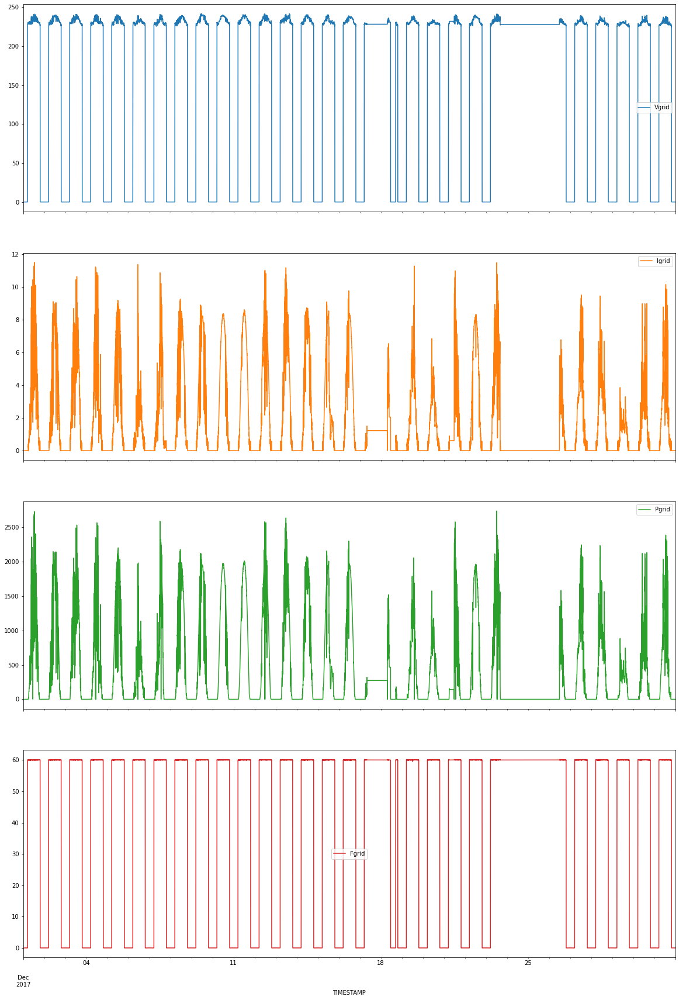

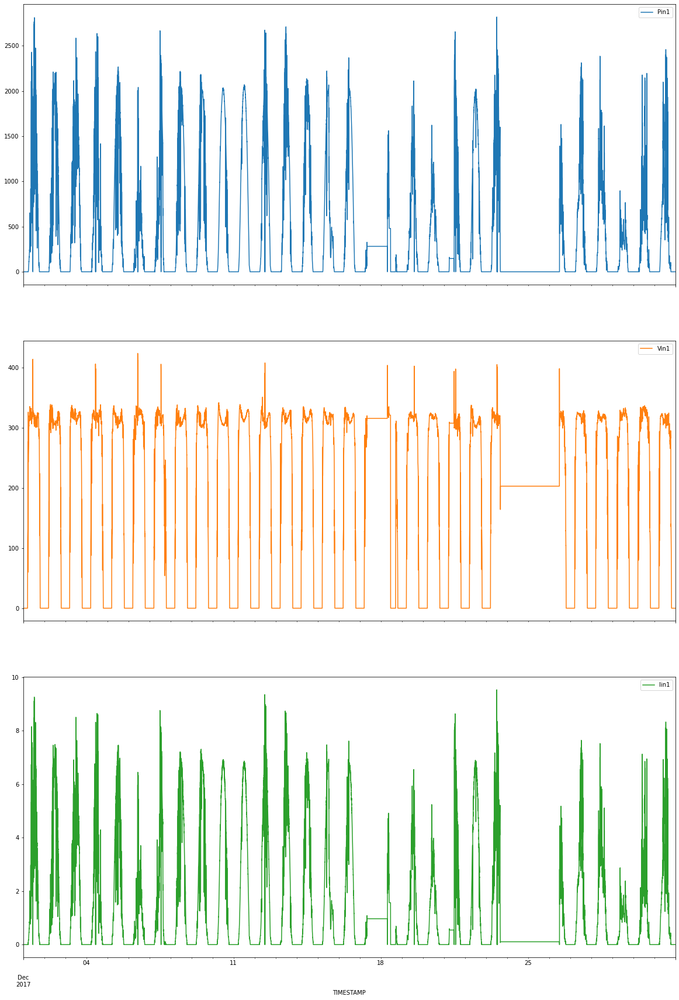

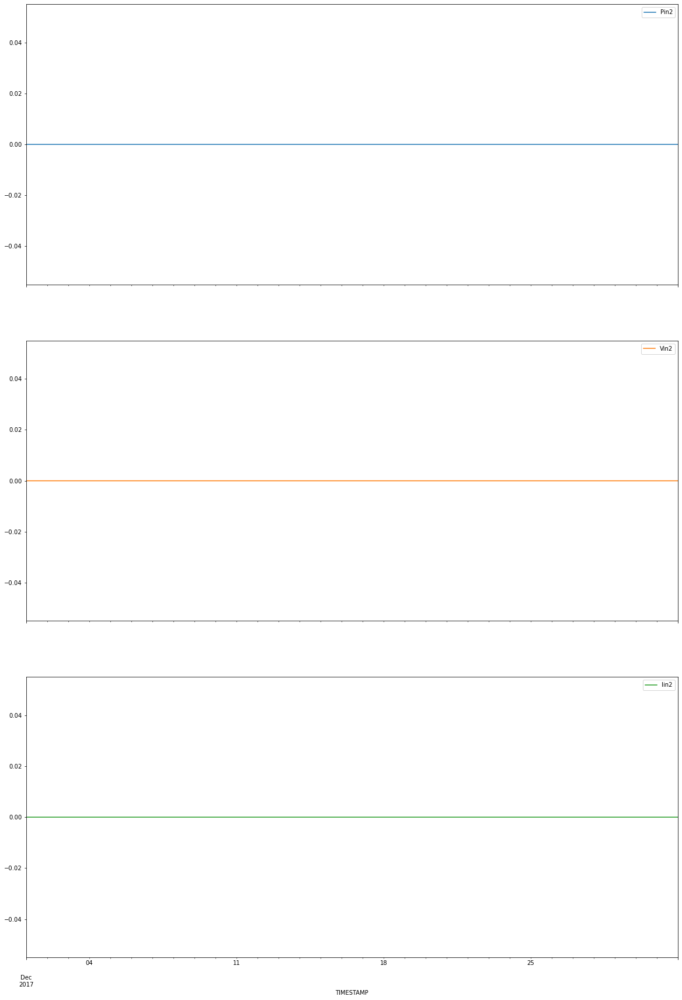

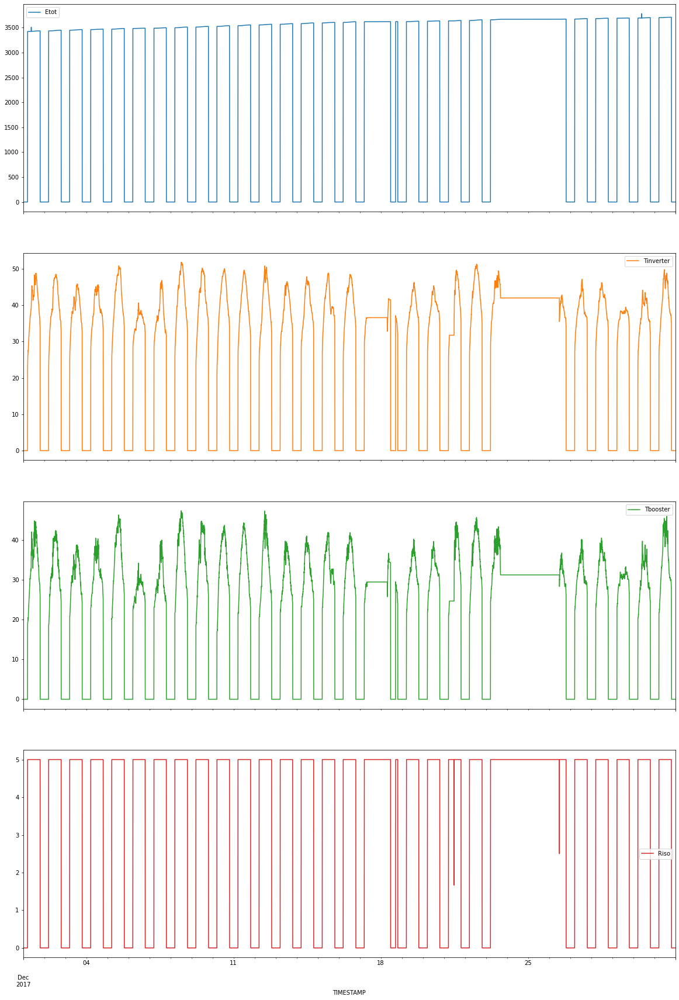

In [69]:
    cdtgridplot = cdtgrid.loc[month].plot(subplots=True, figsize=(20, 30))
    figname = 'CdTe - Grid '+ month+'.jpeg'
    fig = cdtgridplot[0].get_figure()
    fig.savefig(figname)
    
    cdtin1plot = cdtin1.loc[month].plot(subplots=True, figsize=(20, 30))
    figname = 'CdTe - Input 1 '+ month+'.jpeg'
    fig = cdtin1plot[0].get_figure()
    fig.savefig(figname)

    cdtin2plot = cdtin2.loc[month].plot(subplots=True, figsize=(20, 30))
    figname = 'CdTe - Input 2 '+ month+'.jpeg'
    fig = cdtin2plot[0].get_figure()
    fig.savefig(figname)

    cdtinverterplot = cdtinverter.loc[month].plot(subplots=True, figsize=(20, 30))
    figname = 'CdTe - Inverter '+ month+'.jpeg'
    fig = cdtinverterplot[0].get_figure()
    fig.savefig(figname)

In [65]:
dfCDT = dfCDT.set_index('TIMESTAMP')


In [66]:
dfCDT

,Etot,Vgrid,Igrid,Pgrid,Fgrid,Pin1,Vin1,Iin1,Pin2,Vin2,Iin2,Tinverter,Tbooster,Riso
TIMESTAMP,,,,,,,,,,,,,,
2017-07-04 10:45:00,2193.921,234.6536,6.196396,1434.9640,59.98176,1479.3440,319.4513,4.700523,0.0,0,0,39.08350,33.51683,5.0
2017-07-04 10:46:00,2193.947,234.8455,6.196651,1439.2920,59.99952,1484.0010,319.8006,4.718031,0.0,0,0,39.08350,33.30969,5.0
2017-07-04 10:47:00,2193.972,234.7815,6.211050,1441.4260,60.00360,1486.0060,319.7704,4.747102,0.0,0,0,39.21859,33.41356,5.0
2017-07-04 10:48:00,2193.993,234.6642,6.275977,1450.1460,60.00192,1495.5130,320.0895,4.776174,0.0,0,0,39.24561,33.30969,5.0
2017-07-04 10:49:00,2194.021,234.4241,6.284834,1456.0430,59.98608,1501.0760,320.4254,4.810109,0.0,0,0,39.24561,33.15329,5.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-02-11 15:09:00,13115.830,215.2951,2.661140,552.9396,59.97337,570.0408,311.8500,1.941638,0.0,0,0,44.47314,38.33249,5.0
2021-02-11 15:10:00,13115.840,215.6855,2.843410,590.6448,60.01645,608.0389,312.9937,2.030582,0.0,0,0,44.47314,38.43271,5.0
2021-02-11 15:11:00,13115.840,215.6725,2.846778,598.1732,60.00326,615.9943,313.4791,2.041984,0.0,0,0,44.40621,38.42018,5.0


In [84]:
day = "2018-02-19"

In [135]:
    df14 = cdtin1.loc['2018-02-14 06:00:00':'2018-02-14 19:00:00'].Pin1
    df15 = cdtin1.loc['2018-02-15 06:00:00':'2018-02-15 19:00:00'].Pin1
    df16 = cdtin1.loc['2018-02-16 06:00:00':'2018-02-16 19:00:00'].Pin1
    df17 = cdtin1.loc['2018-02-17 06:00:00':'2018-02-17 19:00:00'].Pin1
    df18 = cdtin1.loc['2018-02-18 06:00:00':'2018-02-18 19:00:00'].Pin1
    df19 = cdtin1.loc['2018-02-19 06:00:00':'2018-02-19 19:00:00'].Pin1
    

In [136]:
df16.index = df16.index.time
df17.index = df17.index.time
df18.index = df18.index.time
df19.index = df19.index.time

In [132]:
df14[df14 == df14.max()]

TIMESTAMP
2018-02-14 11:56:00    2629.313
Name: Pin1, dtype: float64

In [130]:
df15[df15 == df15.max()]

TIMESTAMP
2018-02-15 12:42:00    2247.456
Name: Pin1, dtype: float64

In [125]:
df16[df16 == df16.max()]

TIMESTAMP
2018-02-16 12:07:00    2723.936
Name: Pin1, dtype: float64

In [126]:
df17[df17 == df17.max()]

TIMESTAMP
2018-02-17 11:28:00    2696.642
Name: Pin1, dtype: float64

In [127]:
df18[df18 == df18.max()]

TIMESTAMP
2018-02-18 11:45:00    2655.184
Name: Pin1, dtype: float64

In [133]:
df19[df19 == df19.max()]

TIMESTAMP
2018-02-19 12:48:00    2284.775
Name: Pin1, dtype: float64

In [137]:
A = pd.DataFrame(index = df16.index,  columns= ['df16', 'df17', 'df18', 'df19'])

In [138]:

A['df16']= df16
A['df17']= df17
A['df18']= df18
A['df19']= df19


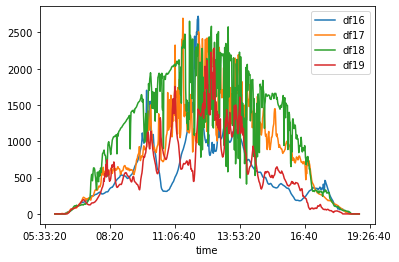

In [139]:
A['df16'].plot()
A['df17'].plot()
A['df18'].plot()
A['df19'].plot()
plt.legend()


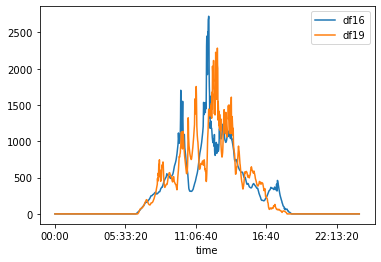

In [103]:
A['df16'].plot()
A['df19'].plot()
plt.legend()

In [116]:
df16


00:00:00    0.0
00:01:00    0.0
00:02:00    0.0
00:03:00    0.0
00:04:00    0.0
           ... 
23:55:00    0.0
23:56:00    0.0
23:57:00    0.0
23:58:00    0.0
23:59:00    0.0
Name: Pin1, Length: 1440, dtype: float64

In [117]:
df16.index

Index([00:00:00, 00:01:00, 00:02:00, 00:03:00, 00:04:00, 00:05:00, 00:06:00,
       00:07:00, 00:08:00, 00:09:00,
       ...
       23:50:00, 23:51:00, 23:52:00, 23:53:00, 23:54:00, 23:55:00, 23:56:00,
       23:57:00, 23:58:00, 23:59:00],
      dtype='object', length=1440)

In [78]:
dfCDT.index

DatetimeIndex(['2017-07-04 10:45:00', '2017-07-04 10:46:00',
               '2017-07-04 10:47:00', '2017-07-04 10:48:00',
               '2017-07-04 10:49:00', '2017-07-04 10:50:00',
               '2017-07-04 10:51:00', '2017-07-04 10:52:00',
               '2017-07-04 10:53:00', '2017-07-04 10:54:00',
               ...
               '2021-02-11 15:04:00', '2021-02-11 15:05:00',
               '2021-02-11 15:06:00', '2021-02-11 15:07:00',
               '2021-02-11 15:08:00', '2021-02-11 15:09:00',
               '2021-02-11 15:10:00', '2021-02-11 15:11:00',
               '2021-02-11 15:12:00', '2021-02-11 15:13:00'],
              dtype='datetime64[ns]', name='TIMESTAMP', length=1828690, freq=None)

In [141]:
main_path = "/Users/nataly/opt/AnacondaProjects/SAPIENS/INVERTER/"

pathCDT = "/Users/nataly/opt/AnacondaProjects/SAPIENS/original/GERACAO/CR1000-Sapiens_HT_SP1_INV_CDT.csv"
pathPSI = "/Users/nataly/opt/AnacondaProjects/SAPIENS/original/GERACAO/CR1000-Sapiens_HT_SP1_INV_PSI.csv"


varCDT =['TIMESTAMP',
         'INV_CDTE_231',
         'INV_CDTE_236',
         'INV_CDTE_237',
         'INV_CDTE_238',
         'INV_CDTE_239',
         'INV_CDTE_240',
         'INV_CDTE_241',
         'INV_CDTE_242',
         'INV_CDTE_243',
         'INV_CDTE_244',
         'INV_CDTE_245',
         'INV_CDTE_246',
         'INV_CDTE_247',
         'INV_CDTE_248']


varCDTA = ['TIMESTAMP',
           'INV_CDTE_331',
           'INV_CDTE_336',
           'INV_CDTE_337',
           'INV_CDTE_338',
           'INV_CDTE_339',
           'INV_CDTE_340',
           'INV_CDTE_341',
           'INV_CDTE_342',
           'INV_CDTE_343',
           'INV_CDTE_344',
           'INV_CDTE_345',
           'INV_CDTE_346',
           'INV_CDTE_347',
           'INV_CDTE_348']

varPSI = ['TIMESTAMP',
          'INV_PSI_431',
          'INV_PSI_436',
          'INV_PSI_437',
          'INV_PSI_438',
          'INV_PSI_439',
          'INV_PSI_440',
          'INV_PSI_441',
          'INV_PSI_442',
          'INV_PSI_443',
          'INV_PSI_444',
          'INV_PSI_445',
          'INV_PSI_446',
          'INV_PSI_447',
          'INV_PSI_448']


column_names = ['TIMESTAMP',
                   'E_tot',
                   'V_grid',
                   'I_grid',
                   'P_grid',
                   'F_grid',
                   'P_in1',
                   'V_in1',
                   'I_in1',
                   'P_in2',
                   'V_in2',
                   'I_in2',
                   'T_inverter',
                   'T_booster',
                   'R_iso'] 

grid = ['V_grid',
        'I_grid',
        'P_grid',
        'F_grid']

input1 = ['P_in1',
          'V_in1',
          'I_in1',]


input2 = ['P_in2',
          'V_in2',
          'I_in2',]

inverter = ['E_tot',
            'T_inverter',
            'T_booster',
            'R_iso']
                   
months = ['2018-01','2018-02','2018-03', '2018-04','2018-05','2018-06','2018-07','2018-08', '2018-09','2018-10','2018-11','2018-12',
          '2019-01','2019-02','2019-03', '2019-04','2019-05','2019-06','2019-07','2019-08', '2019-09','2019-10','2019-11','2019-12',
          '2020-01','2020-02','2020-03', '2020-04','2020-05','2020-06','2020-07','2020-08', '2020-09','2020-10','2020-11','2020-12',
          '2021-01']

In [142]:
dfCDT  = pd.read_csv(pathCDT, usecols=varCDT)
dfCDT.columns = column_names
print(dfCDT.shape)
dfCDT['TIMESTAMP'] = dfCDT['TIMESTAMP'].astype(np.datetime64)
dfCDT = dfCDT.fillna(-9999)
dfCDT = dfCDT.sort_values(by=['TIMESTAMP'])
dfCDT= dfCDT.drop_duplicates()
dfCDT = dfCDT.set_index('TIMESTAMP')
print(dfCDT.shape)


dfCDTA = pd.read_csv(pathCDT, usecols=varCDTA)
dfCDTA.columns = column_names
print(dfCDTA.shape)
dfCDTA['TIMESTAMP'] = dfCDTA['TIMESTAMP'].astype(np.datetime64)
dfCDTA = dfCDTA.fillna(-9999)
dfCDTA = dfCDTA.sort_values(by=['TIMESTAMP'])
dfCDTA= dfCDTA.drop_duplicates()
dfCDTA = dfCDTA.set_index('TIMESTAMP')
print(dfCDTA.shape)


dfPSI  = pd.read_csv(pathPSI, usecols=varPSI)
dfPSI.columns = column_names
print(dfPSI.shape)
dfPSI['TIMESTAMP'] = dfPSI['TIMESTAMP'].astype(np.datetime64)
dfPSI = dfPSI.fillna(-9999)
dfPSI = dfPSI.sort_values(by=['TIMESTAMP'])
dfPSI= dfPSI.drop_duplicates()
dfPSI = dfPSI.set_index('TIMESTAMP')
print(dfPSI.shape)


(1833804, 15)
(1828690, 14)
(1833804, 15)
(1828690, 14)
(1666093, 15)
(1665677, 14)


In [143]:
cdtgrid      = dfCDT[grid]  
cdtin1       = dfCDT[input1]
cdtin2       = dfCDT[input2]
cdtinverter   = dfCDT[inverter]

cdtagrid      = dfCDTA[grid]  
cdtain1       = dfCDTA[input1]
cdtain2       = dfCDTA[input2]
cdtainverter   = dfCDTA[inverter]

psigrid      = dfPSI[grid]  
psiin1       = dfPSI[input1]
psiin2       = dfPSI[input2]
psiinverter   = dfPSI[inverter]


/Users/nataly/opt/anaconda3/lib/python3.8/site-packages/pandas/plotting/_matplotlib/tools.py:196: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(**fig_kw)


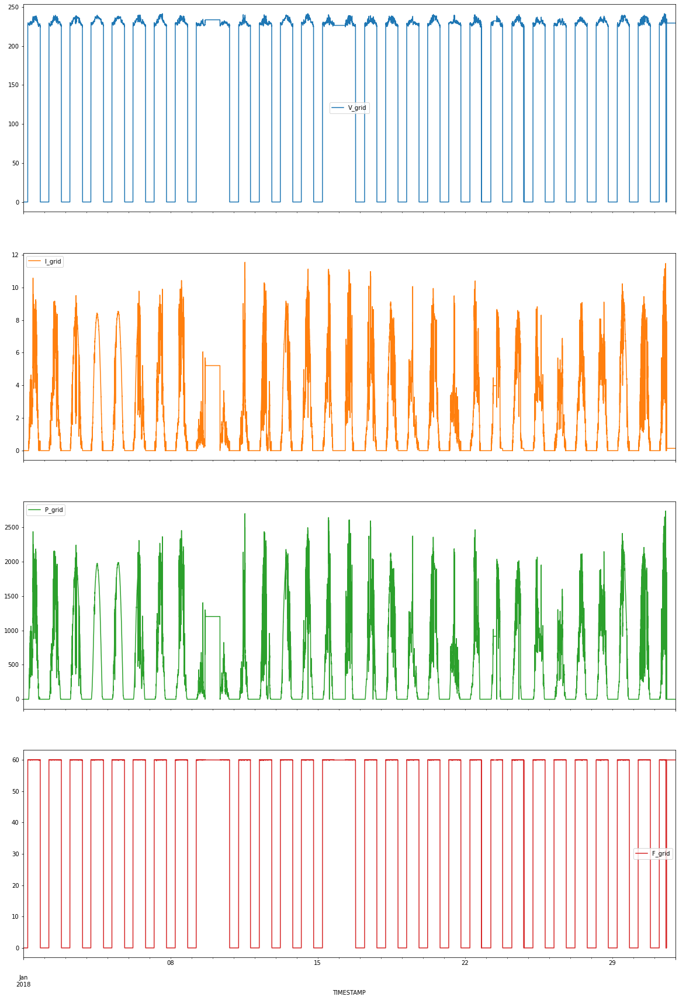

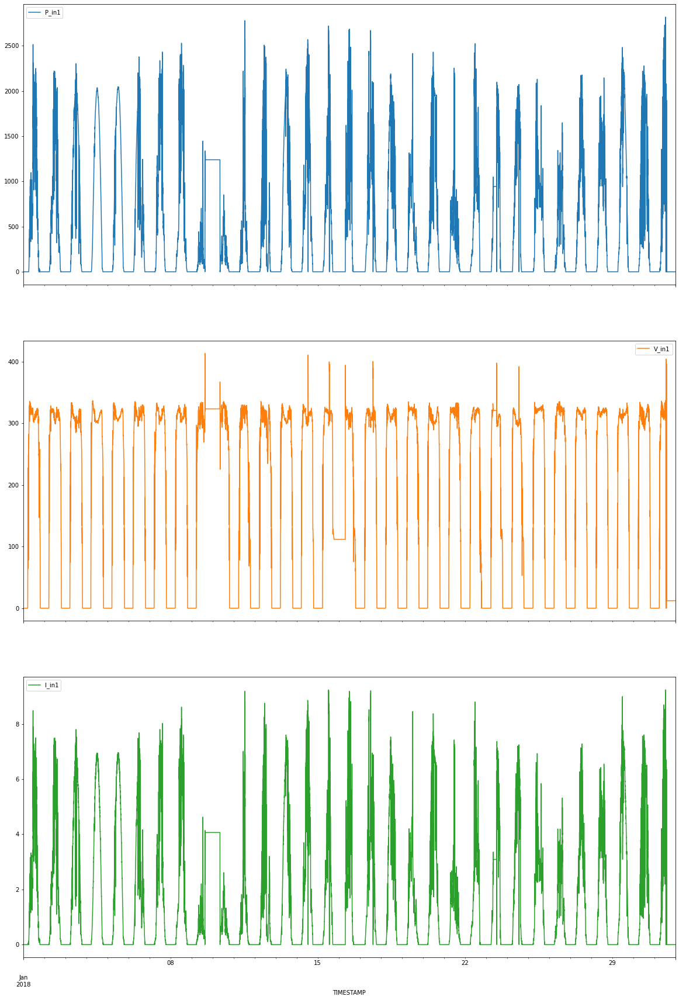

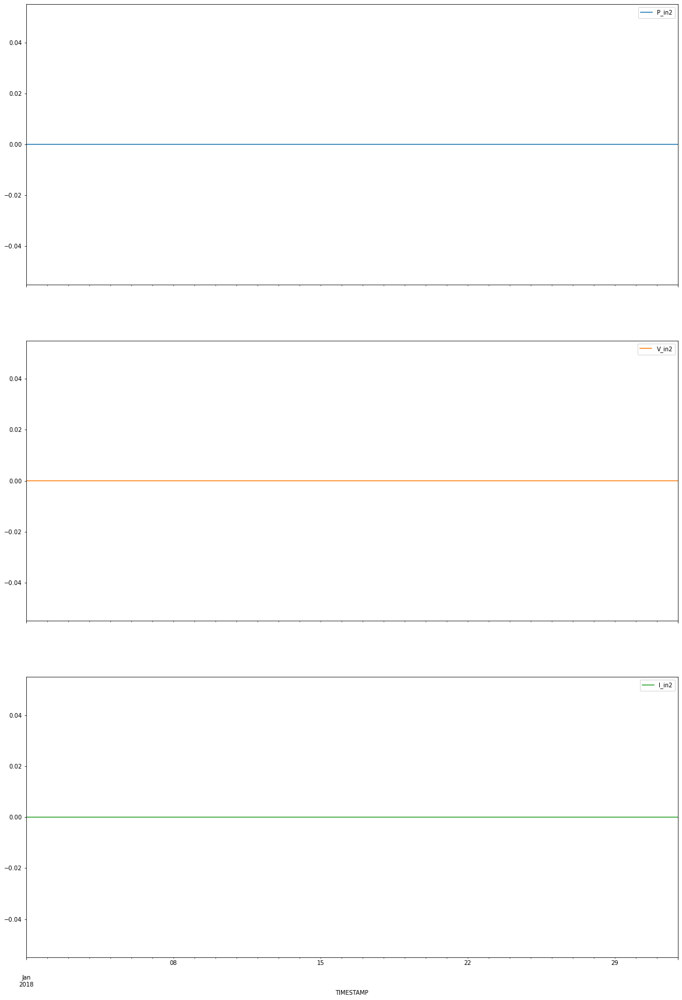

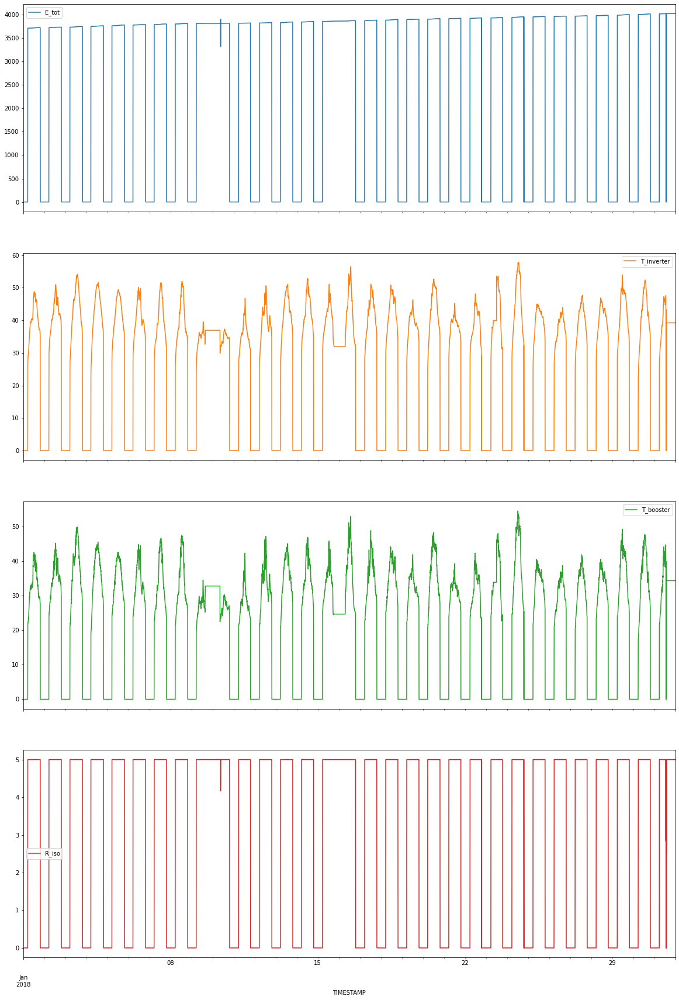

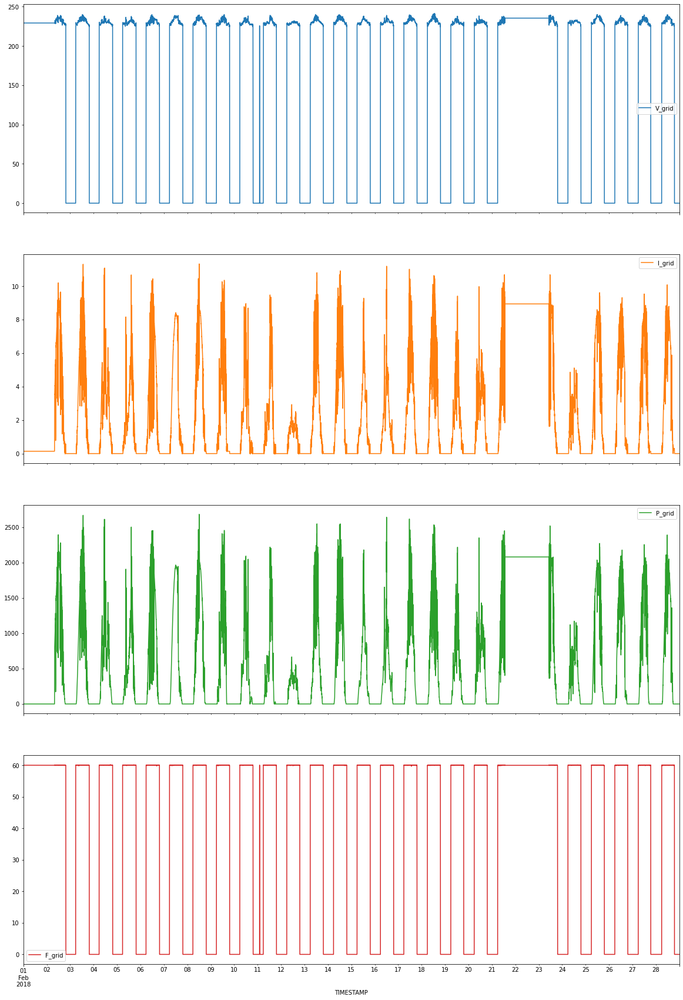

...

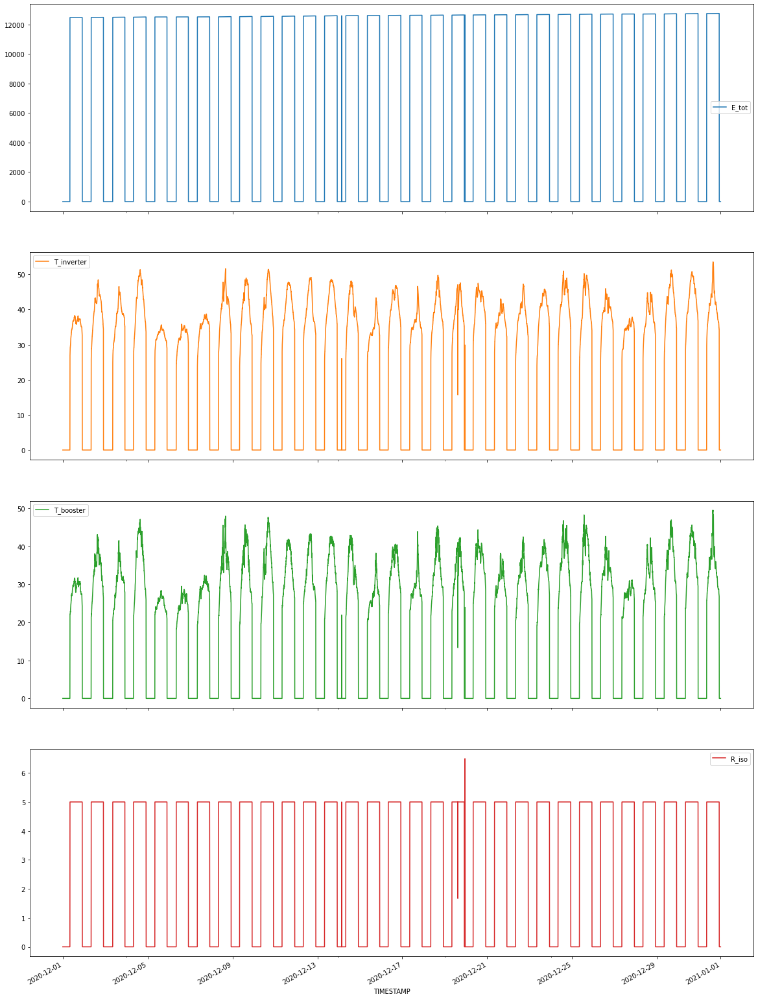

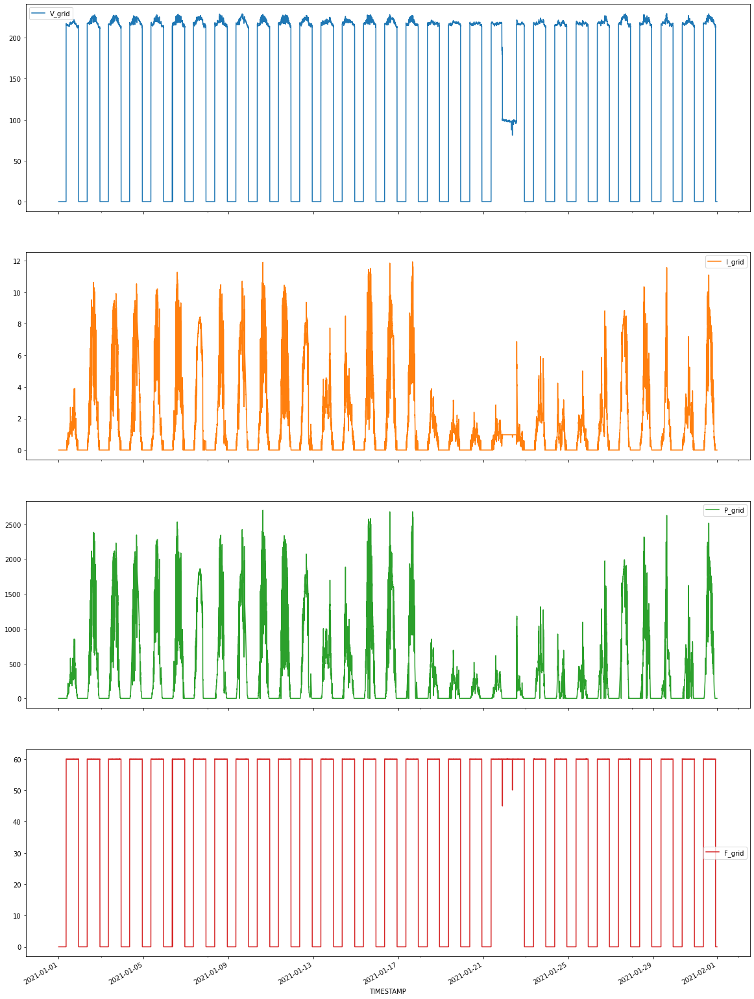

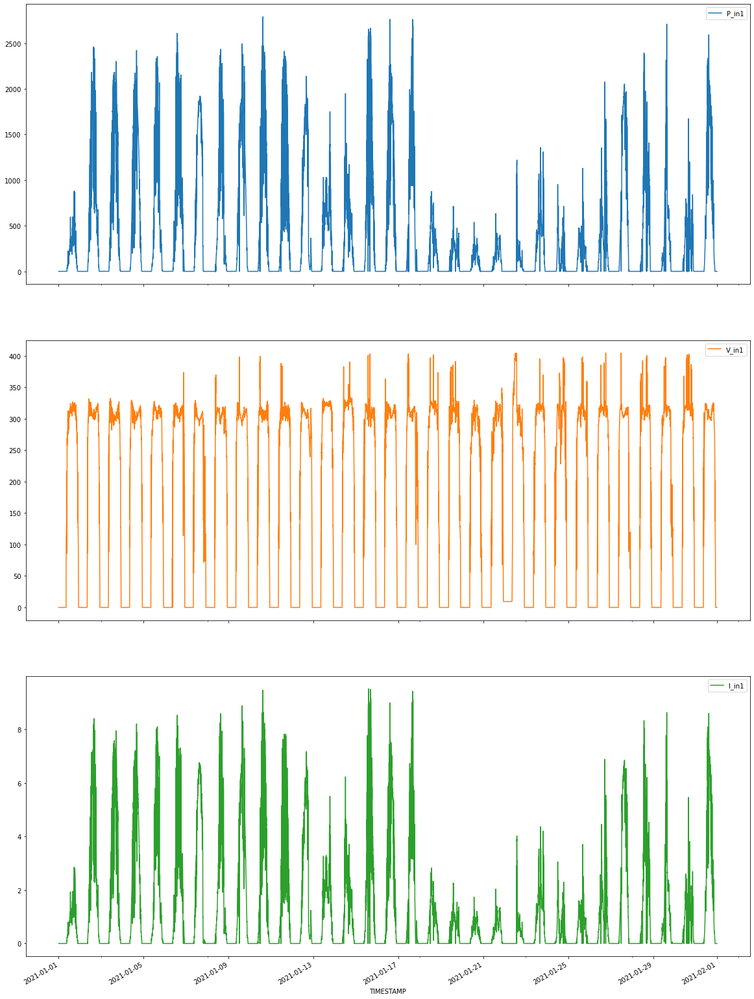

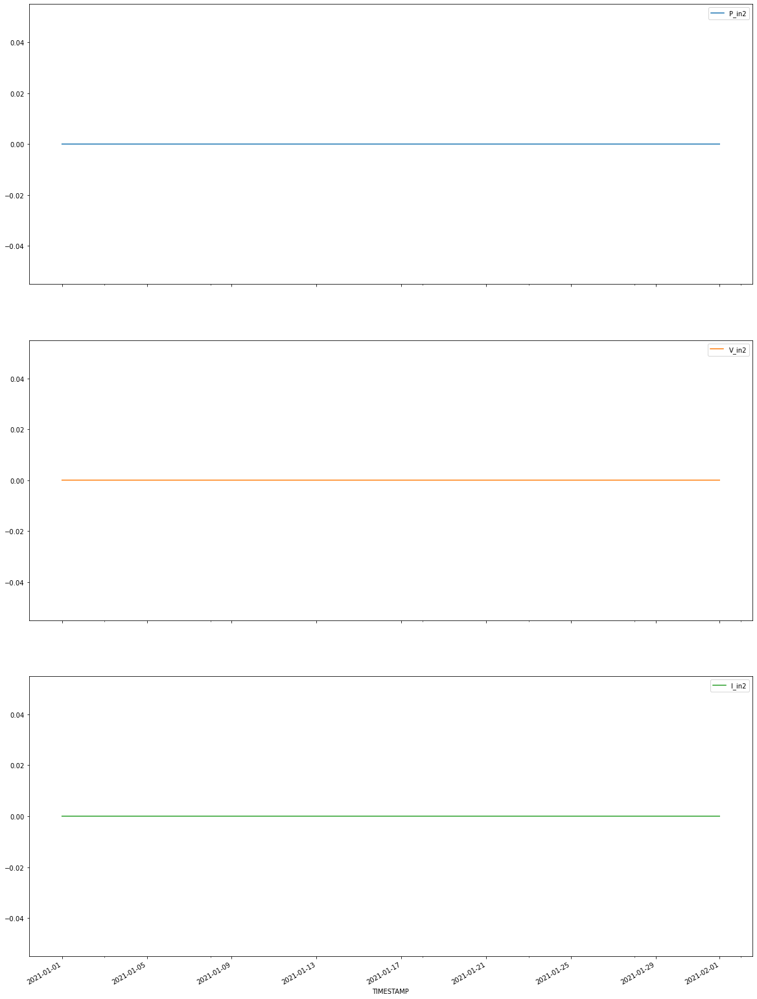

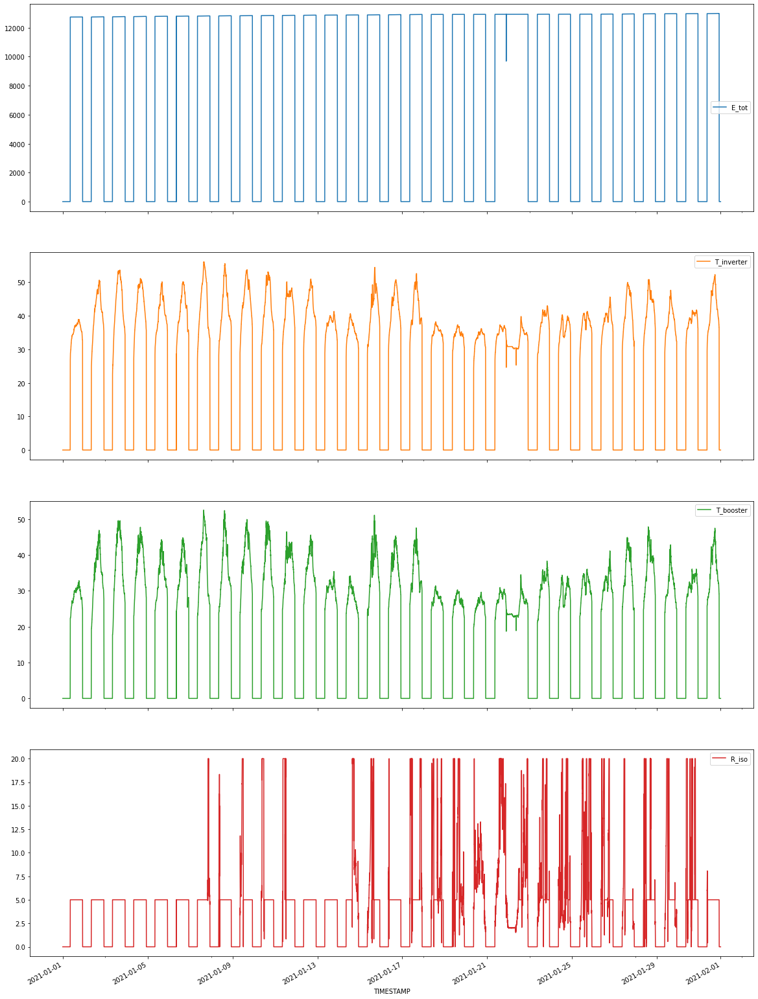

In [144]:
for month in months:
    cdtgridplot = cdtgrid.loc[month].plot(subplots=True, figsize=(20, 30))
    figname = 'CdTe - Grid '+ month+'.jpeg'
    fig = cdtgridplot[0].get_figure()
    fig.savefig(figname)
    
    cdtin1plot = cdtin1.loc[month].plot(subplots=True, figsize=(20, 30))
    figname = 'CdTe - Input 1 '+ month+'.jpeg'
    fig = cdtin1plot[0].get_figure()
    fig.savefig(figname)

    cdtin2plot = cdtin2.loc[month].plot(subplots=True, figsize=(20, 30))
    figname = 'CdTe - Input 2 '+ month+'.jpeg'
    fig = cdtin2plot[0].get_figure()
    fig.savefig(figname)

    cdtinverterplot = cdtinverter.loc[month].plot(subplots=True, figsize=(20, 30))
    figname = 'CdTe - Inverter '+ month+'.jpeg'
    fig = cdtinverterplot[0].get_figure()
    fig.savefig(figname)

In [145]:
for month in months:
    cdtagridplot = cdtagrid.loc[month].plot(subplots=True, figsize=(20, 30))
    figname = 'CdTeA - Grid '+ month+'.jpeg'
    fig = cdtagridplot[0].get_figure()
    fig.savefig(figname)
    fig.clf()

    cdtain1plot = cdtain1.loc[month].plot(subplots=True, figsize=(20, 30))
    figname = 'CdTeA - Input 1 '+ month+'.jpeg'
    fig = cdtain1plot[0].get_figure()
    fig.savefig(figname)
    fig.clf()

    cdtain2plot = cdtain2.loc[month].plot(subplots=True, figsize=(20, 30))
    figname = 'CdTeA - Input 2 '+ month+'.jpeg'
    fig = cdtain2plot[0].get_figure()
    fig.savefig(figname)
    fig.clf()

    cdtainverterplot = cdtainverter.loc[month].plot(subplots=True, figsize=(20, 30))
    figname = 'CdTeA - Inverter '+ month+'.jpeg'
    fig = cdtainverterplot[0].get_figure()
    fig.savefig(figname)
    fig.clf()

    psigridplot = psigrid.loc[month].plot(subplots=True, figsize=(20, 30))
    figname = 'PSI - Grid '+ month+'.jpeg'
    fig = psigridplot[0].get_figure()
    fig.savefig(figname)
    fig.clf()

    psiin1plot = psiin1.loc[month].plot(subplots=True, figsize=(20, 30))
    figname = 'PSI - Input 1 '+ month+'.jpeg'
    fig = psiin1plot[0].get_figure()
    fig.savefig(figname)
    fig.clf()

    psiin2plot = psiin2.loc[month].plot(subplots=True, figsize=(20, 30))
    figname = 'PSI - Input 2 '+ month+'.jpeg'
    fig = psiin2plot[0].get_figure()
    fig.savefig(figname)
    fig.clf()

    psiinverterplot = psiinverter.loc[month].plot(subplots=True, figsize=(20, 30))
    figname = 'PSI - Inverter '+ month+'.jpeg'
    fig = psiinverterplot[0].get_figure()
    fig.savefig(figname)
    fig.clf()

/Users/nataly/opt/anaconda3/lib/python3.8/site-packages/pandas/plotting/_matplotlib/tools.py:196: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(**fig_kw)


<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

In [147]:
main_path

'/Users/nataly/opt/AnacondaProjects/SAPIENS/INVERTER/'

In [148]:
    dfCDT.to_csv(main_path + 'CDT.csv')
    dfCDTA.to_csv(main_path + 'CDTA.csv')
    dfPSI.to_csv(main_path + 'PSI.csv')